# ****U-Net 기반 컬러화 모델****

### 1. 라이브러리 및 설정

In [ ]:
import numpy as np
import tensorflow as tf
from keras import layers
from keras.layers import Conv2D, UpSampling2D, Input, Dropout
from keras.models import Model
from keras.callbacks import LearningRateScheduler
from keras.preprocessing.image import img_to_array
import cv2
import os
import re
import matplotlib.pyplot as plt
from tqdm import tqdm
from google.colab import drive

drive.mount('/content/drive')


Mounted at /content/drive


### 2. 데이터 로드 및 정렬 함수 정의

In [ ]:
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)', key)]
    return sorted(data, key=alphanum_key)

# 이미지 크기 설정
SIZE = 320

In [ ]:
# 경로 설정
color_path = '/landscape_images/color'
gray_path = '/landscape_images/gray'

# 컬러 이미지 로드 및 전처리
color_img = []
files = sorted_alphanumeric(os.listdir(color_path))
for i in tqdm(files):
    if i == '6000.jpg':
        break
    img = cv2.imread(os.path.join(color_path, i), 1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))

# 그레이 이미지 로드 및 전처리
gray_img = []
files = sorted_alphanumeric(os.listdir(gray_path))
for i in tqdm(files):
    if i == '6000.jpg':
        break
    img = cv2.imread(os.path.join(gray_path, i), 1)
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))

# 데이터 확인
print(f"Color image 개수: {len(color_img)}")
print(f"Gray image 개수: {len(gray_img)}")


 84%|████████▍ | 6000/7129 [04:32<00:51, 22.05it/s] 

Color image 개수: 6000
Gray image 개수: 6000


### 3. Dataset 시각화

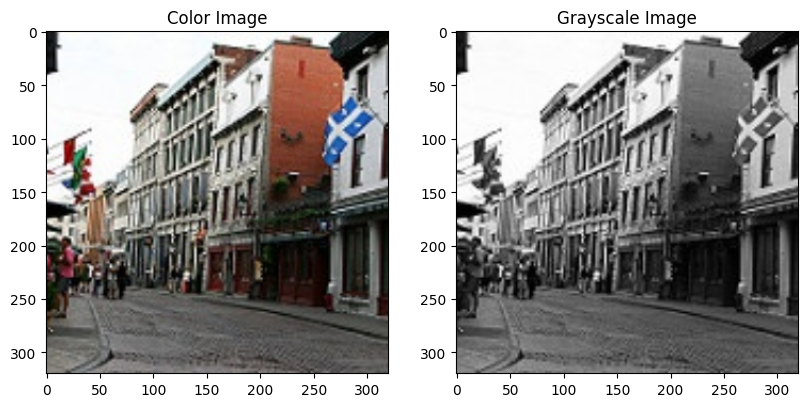

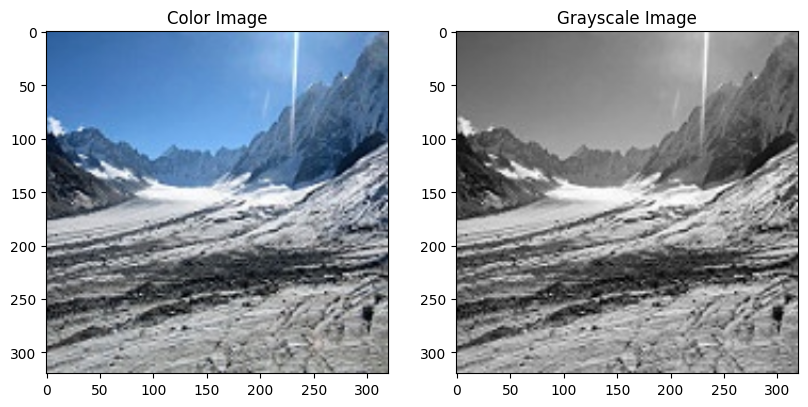

In [ ]:
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image')
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image')
    plt.imshow(grayscale)
    plt.show()

#sample data 확인
for i in range(3,5):
     plot_images(color_img[i],gray_img[i])

### 4 . Dataset 분할 및 Reshape

In [ ]:
# training Data, test Data 분할
train_gray_image = gray_img[:5500]
train_color_image = color_img[:5500]
test_gray_image = gray_img[5500:]
test_color_image = color_img[5500:]

# Data Reshape
train_g = np.reshape(train_gray_image, (len(train_gray_image), SIZE, SIZE, 3))
train_c = np.reshape(train_color_image, (len(train_color_image), SIZE, SIZE, 3))
test_g = np.reshape(test_gray_image, (len(test_gray_image), SIZE, SIZE, 3))
test_c = np.reshape(test_color_image, (len(test_color_image), SIZE, SIZE, 3))

# Data 확인
print('Train color image shape:', train_c.shape)
print('Test color image shape:', test_c.shape)


Train color image shape: (5500, 320, 320, 3)
Test color image shape: (500, 320, 320, 3)


### 5. Model 제작

#### 5-1. U-Net Down-sampling 및 Up-sampling Layer 정의

In [ ]:
def down(filters, kernel_size, apply_batch_normalization=True, apply_dropout=False):
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(filters, kernel_size, padding='same', strides=2))
    if apply_batch_normalization:
        model.add(layers.BatchNormalization())
    if apply_dropout:
        model.add(layers.Dropout(0.2))
    model.add(layers.LeakyReLU())
    return model

def up(filters, kernel_size, apply_dropout=False):
    model = tf.keras.Sequential()
    model.add(layers.Conv2DTranspose(filters, kernel_size, padding='same', strides=2))
    if apply_dropout:
        model.add(layers.Dropout(0.2))
    model.add(layers.LeakyReLU())
    return model


#### 5-2. U-Net 모델 생성

In [ ]:
def create_unet_model():
    inputs = layers.Input(shape=(SIZE, SIZE, 3))

    # Down-sampling
    d1 = down(32, (5, 5), apply_batch_normalization=False, apply_dropout=True)(inputs)
    d2 = down(64, (5, 5))(d1)
    d3 = down(128, (5, 5))(d2)
    d4 = down(256, (5, 5))(d3)
    d5 = down(512, (5, 5))(d4)

    # Up-sampling
    u1 = up(512, (3, 3))(d5)
    u1 = layers.concatenate([u1, d4])
    u2 = up(256, (3, 3))(u1)
    u2 = layers.concatenate([u2, d3])
    u3 = up(128, (3, 3))(u2)
    u3 = layers.concatenate([u3, d2])
    u4 = up(64, (3, 3))(u3)
    u4 = layers.concatenate([u4, d1])
    u5 = up(3, (3, 3))(u4)

    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(u5)
    return Model(inputs=inputs, outputs=outputs)

# 모델 초기화 및 요약
model = create_unet_model()
model.summary()


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 320, 320, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential (Sequential)   │ (None, 160, 160, 32)   │          2,432 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_1 (Sequential) │ (None, 80, 80, 64)     │         51,520 │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_2 (Sequential) │ (None, 40, 40, 128)    │        205,440 │ sequential_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_3 (Sequential) │ (None, 20, 20, 256)    │        820,480 │ sequential_2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_4 (Sequential) │ (None, 10, 10, 512)    │      3,279,360 │ sequential_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_5 (Sequential) │ (None, 20, 20, 512)    │      2,359,808 │ sequential_4[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 20, 20, 768)    │              0 │ sequential_5[0][0],    │
│                           │                        │                │ sequential_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_6 (Sequential) │ (None, 40, 40, 256)    │      1,769,728 │ concatenate[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_1             │ (None, 40, 40, 384)    │              0 │ sequential_6[0][0],    │
│ (Concatenate)             │                        │                │ sequential_2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_7 (Sequential) │ (None, 80, 80, 128)    │        442,496 │ concatenate_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_2             │ (None, 80, 80, 192)    │              0 │ sequential_7[0][0],    │
│ (Concatenate)             │                        │                │ sequential_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_8 (Sequential) │ (None, 160, 160, 64)   │        110,656 │ concatenate_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_3             │ (None, 160, 160, 96)   │              0 │ sequential_8[0][0],    │
│ (Concatenate)             │                        │                │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_9 (Sequential) │ (None, 320, 320, 3)    │          2,595 │ concatenate_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 320, 320, 3)    │             12 │ sequential_9[0][0]     │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 9,044,527 (34.50 MB)

 Trainable params: 9,042,607 (34.49 MB)

 Non-trainable params: 1,920 (7.50 KB)

### 6. Perceptual Loss 정의 및 학습

In [ ]:
from tensorflow.keras.applications import VGG19

# VGG19 기반 Feature Extractor 설정
vgg = VGG19(include_top=False, weights='imagenet', input_shape=(SIZE, SIZE, 3))
vgg.trainable = False
feature_extractor = Model(inputs=vgg.input, outputs=vgg.get_layer('block5_conv4').output)

# Perceptual Loss 함수
def perceptual_loss(y_true, y_pred):
    true_features = feature_extractor(y_true)
    pred_features = feature_extractor(y_pred)
    return tf.reduce_mean(tf.square(true_features - pred_features))

# 모델 컴파일
model.compile(optimizer='adam', loss=perceptual_loss, metrics=['accuracy'])

# Learning Rate Scheduler
def lr_scheduler(epoch, lr):
    return float(lr * tf.math.exp(-0.1)) if epoch > 20 else float(lr)

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


### 7. 학습 및 평가

In [ ]:
# 모델 학습
model.fit(train_g, train_c, epochs=50, batch_size=8, callbacks=[LearningRateScheduler(lr_scheduler)])

# 모델 평가
model.evaluate(test_g, test_c)


Epoch 1/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 64s 60ms/step - accuracy: 0.3746 - loss: 0.0280 - learning_rate: 0.0010
Epoch 2/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 30s 43ms/step - accuracy: 0.3893 - loss: 0.0065 - learning_rate: 0.0010
Epoch 3/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 30s 43ms/step - accuracy: 0.4002 - loss: 0.0060 - learning_rate: 0.0010
Epoch 4/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4042 - loss: 0.0057 - learning_rate: 0.0010
Epoch 5/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4066 - loss: 0.0055 - learning_rate: 0.0010
Epoch 6/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4045 - loss: 0.0054 - learning_rate: 0.0010
Epoch 7/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4071 - loss: 0.0053 - learning_rate: 0.0010
Epoch 8/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4153 - loss: 0.0051 - learning_rate: 0.0010
Epoch 9/50
688/688 ━━━━━━━━━━━━━━━━━━━━ 29s 43ms/step - accuracy: 0.4099 - loss: 0.0050 - learning_rate:

[0.00524256844073534, 0.42255640029907227]

### 8. PSNR & SSIM 계산


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import numpy as np

# PSNR 및 SSIM 계산 함수
def evaluate_images(test_gray_image, test_color_image, model, size):
    psnr_scores = []
    ssim_scores = []

    for i in range(len(test_gray_image)):
        predicted = np.clip(model.predict(test_gray_image[i].reshape(1, size, size, 3)), 0.0, 1.0).reshape(size, size, 3)
        true = test_color_image[i]

        psnr_value = psnr(true, predicted, data_range=true.max() - true.min())
        psnr_scores.append(psnr_value)

        ssim_value = ssim(true, predicted, multichannel=True, data_range=true.max() - true.min(), win_size=3)
        ssim_scores.append(ssim_value)

    avg_psnr = np.mean(psnr_scores)
    avg_ssim = np.mean(ssim_scores)
    print(f"평균 PSNR: {avg_psnr:.2f}")
    print(f"평균 SSIM: {avg_ssim:.4f}")

    return psnr_scores, ssim_scores

SIZE = 320  # 이미지 크기
psnr_scores, ssim_scores = evaluate_images(test_gray_image, test_color_image, model, SIZE)


max_psnr = np.max(psnr_scores)
max_ssim = np.max(ssim_scores)
print(f"최대 PSNR: {max_psnr:.2f}")
print(f"최대 SSIM: {max_ssim:.4f}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━

### 9. 학습 결과 이미지 출력

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


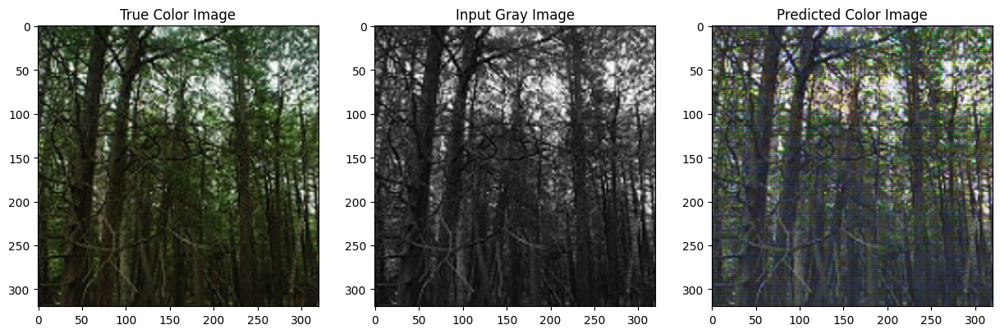

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


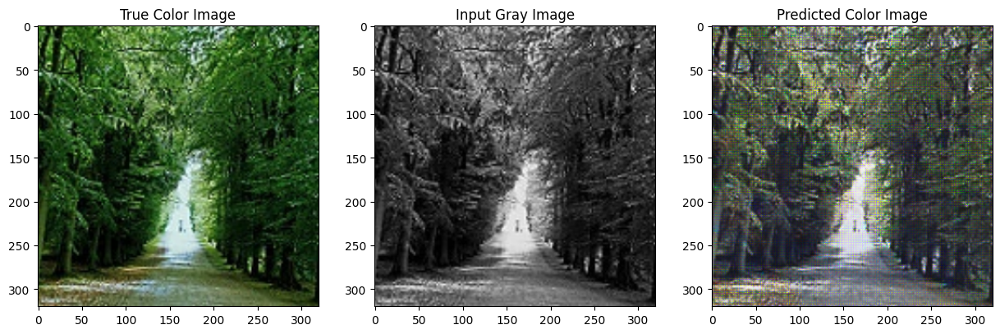

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


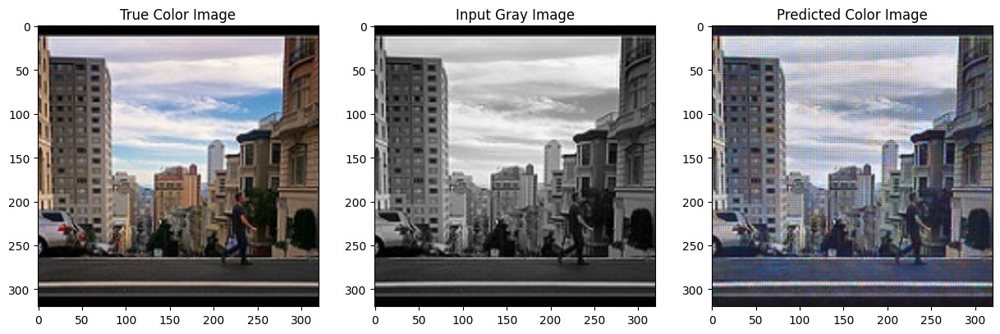

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


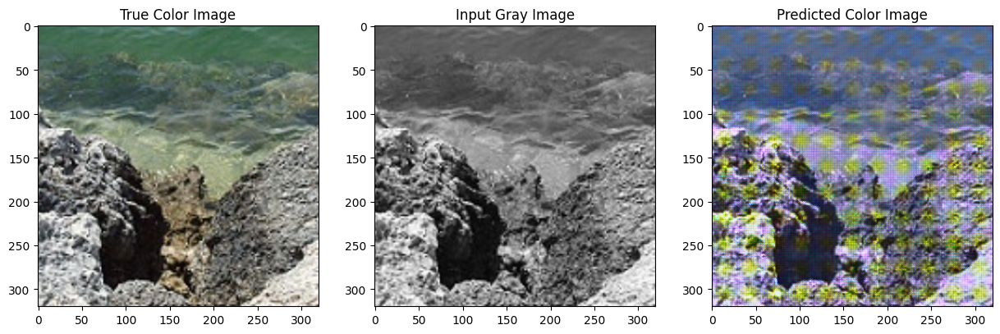

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


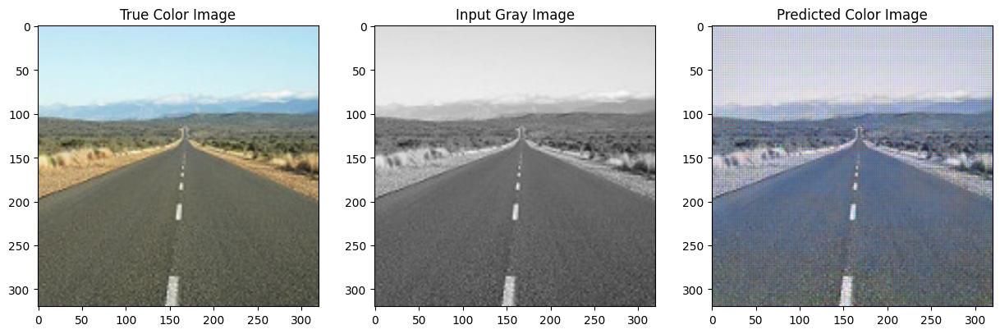

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


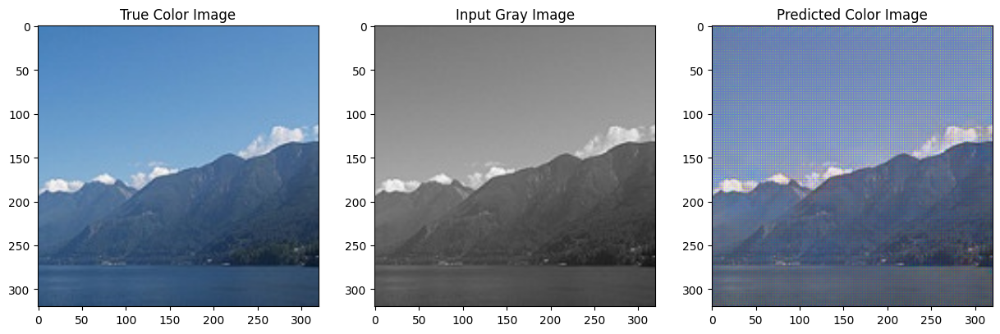

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


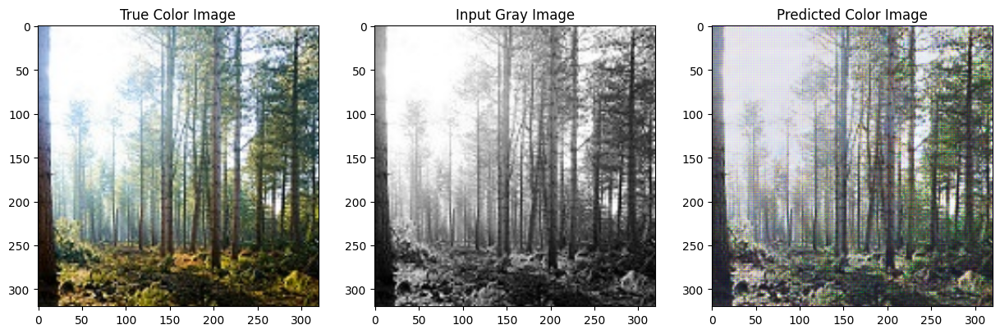

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


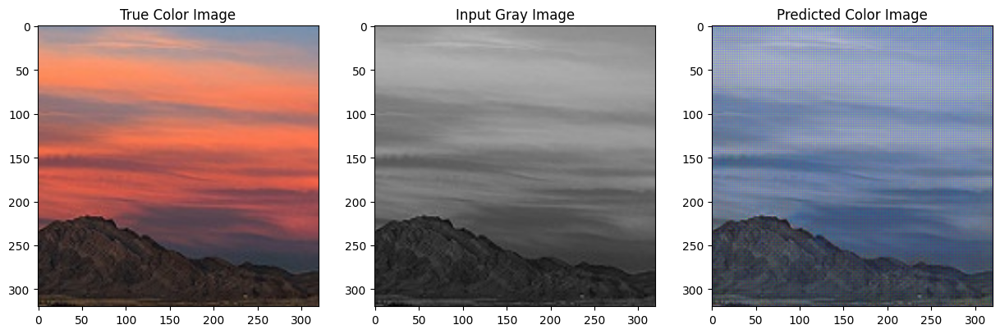

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


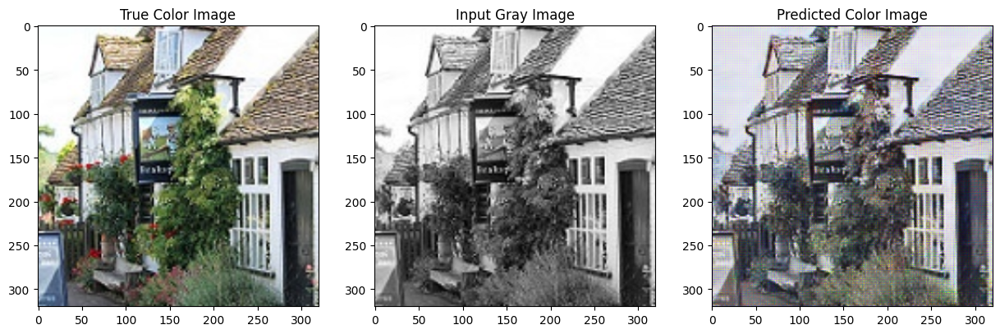

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


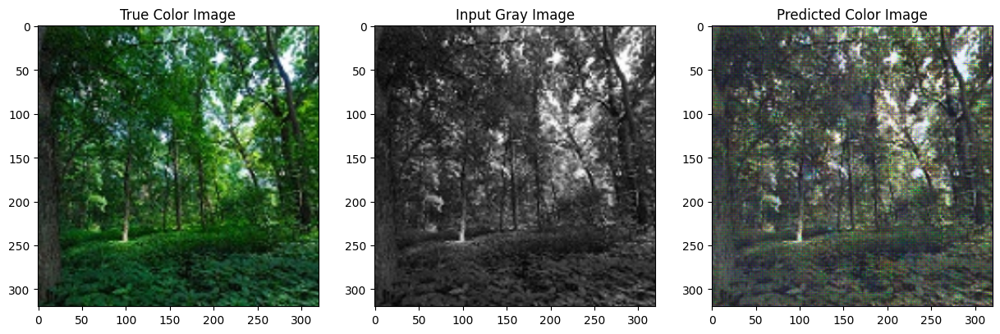

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


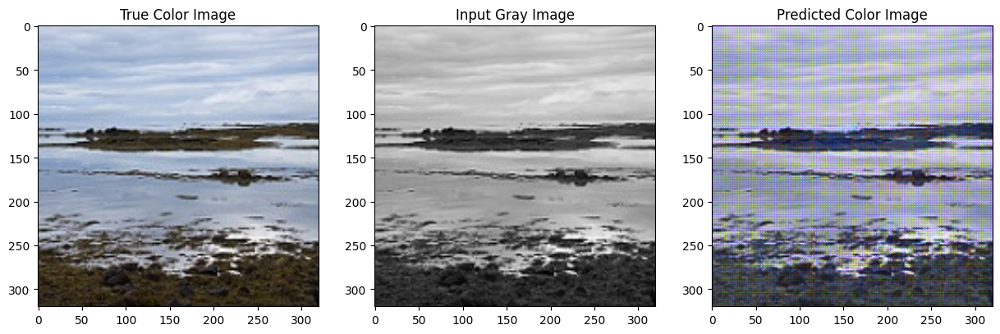

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


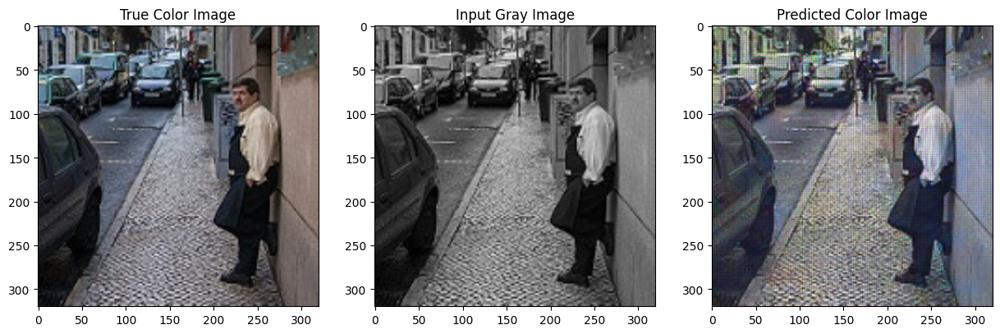

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


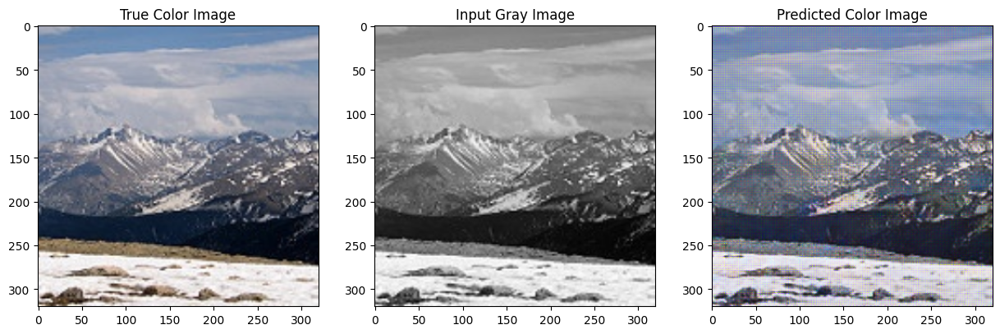

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


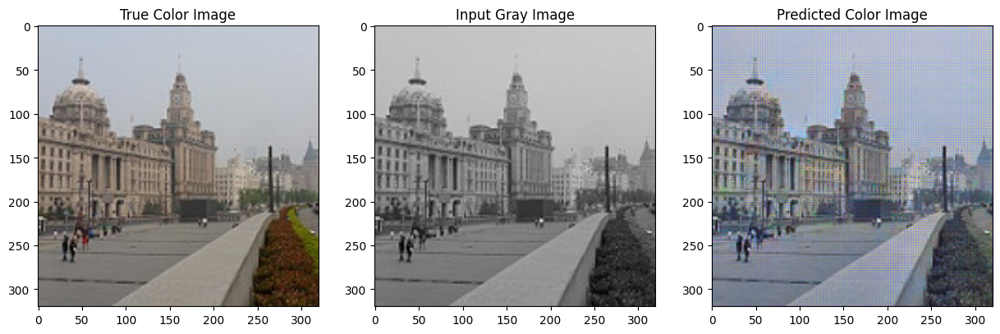

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


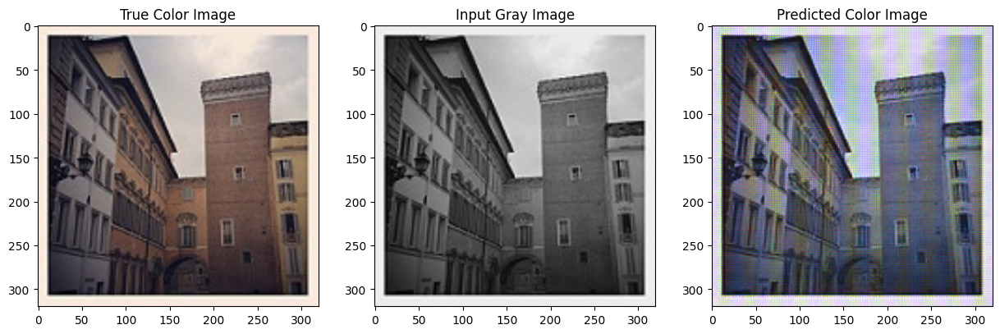

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


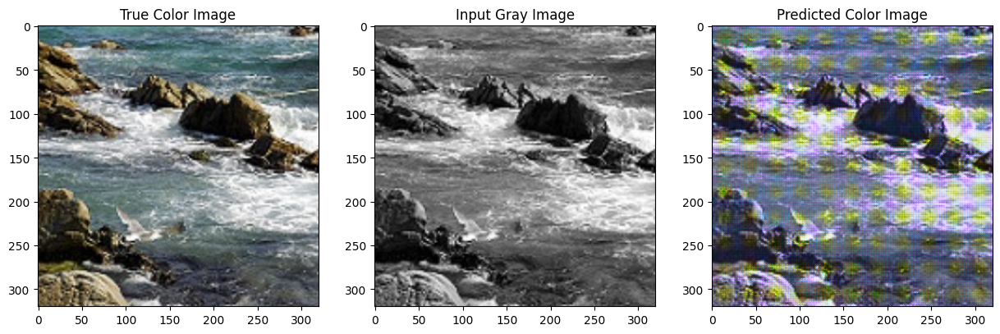

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


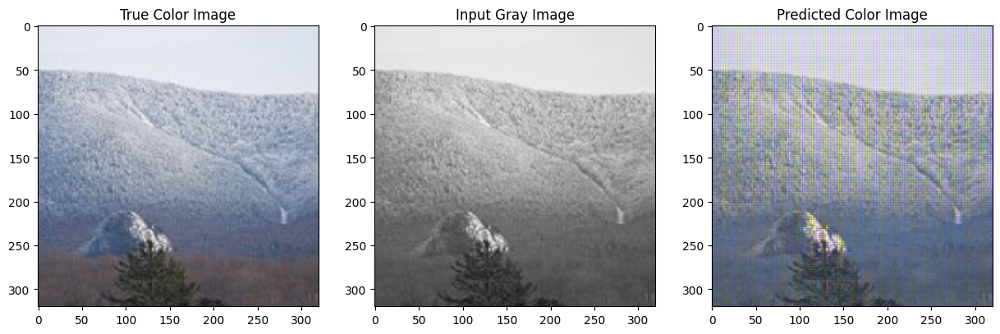

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


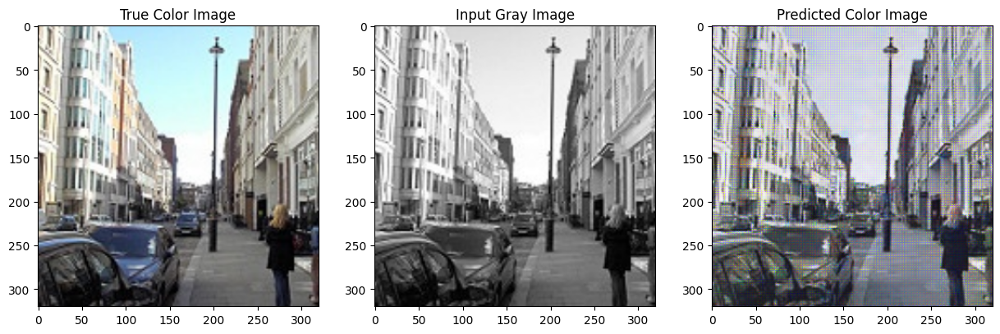

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


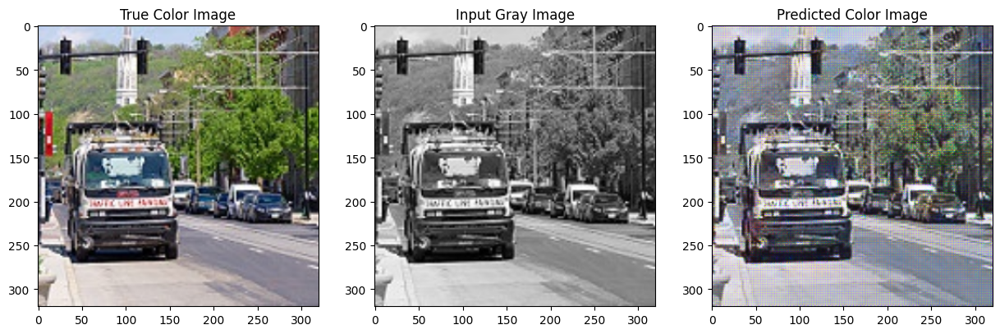

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


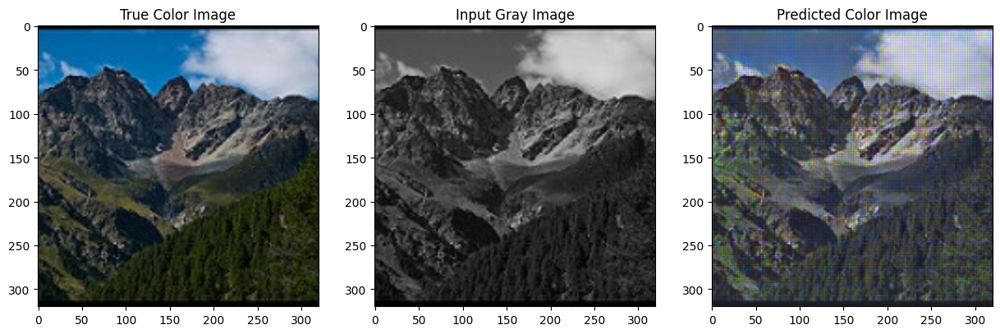

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


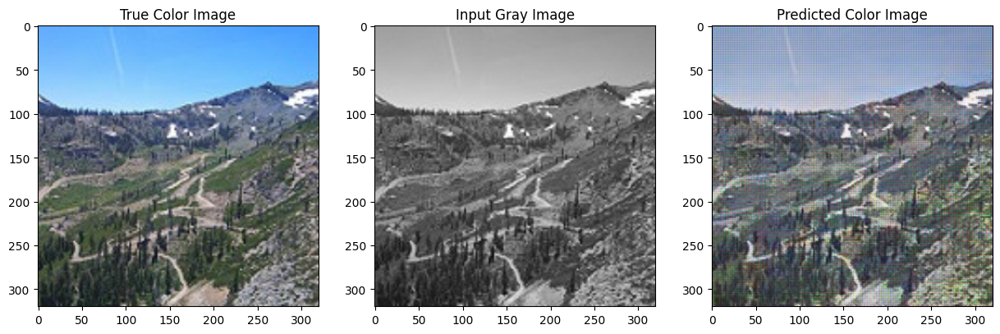

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


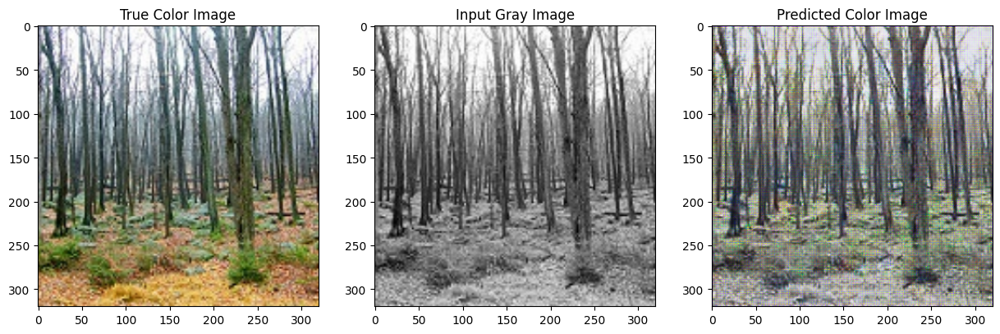

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


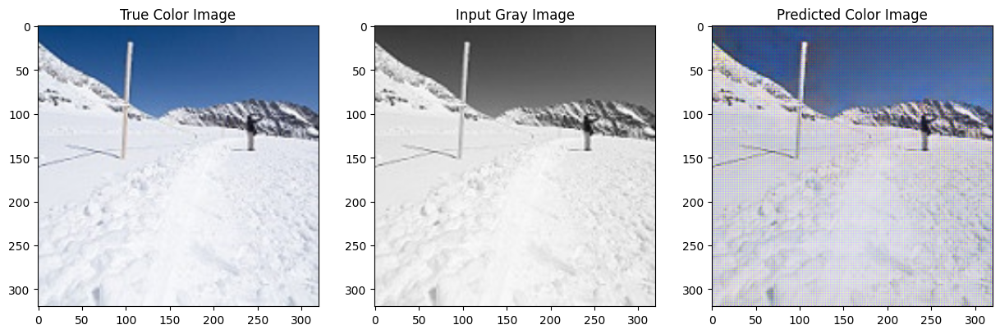

In [ ]:
def predict_and_plot(start_index, end_index):
    for index in range(start_index, end_index):
        gray_image_input = np.expand_dims(test_gray_image[index], axis=0)
        if gray_image_input.shape[-1] == 1:
            gray_image_input = np.repeat(gray_image_input, 3, axis=-1)

        predicted_image = np.clip(model.predict(gray_image_input)[0], 0.0, 1.0)

        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 2)
        plt.title('Input Gray Image')
        plt.imshow(test_gray_image[index], cmap='gray')

        plt.subplot(1, 3, 1)
        plt.title('True Color Image')
        plt.imshow(test_color_image[index])

        plt.subplot(1, 3, 3)
        plt.title('Predicted Color Image')
        plt.imshow(predicted_image)

        plt.show()

predict_and_plot(50, 58)
predict_and_plot(0, 15)


### 10. 대응되는 color image 없는 흑백 이미지 컬러로 출력

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


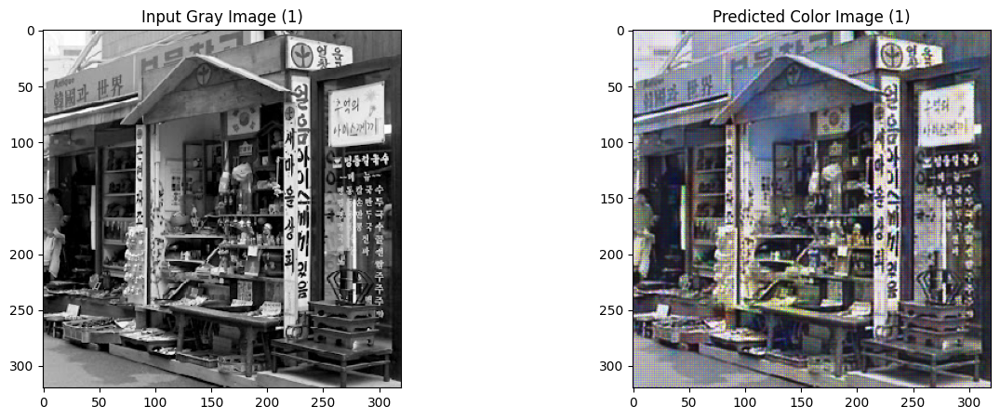

In [ ]:
test_data_path = '/landscape_images/test'

# 이미지 크기 설정
SIZE = 320

# 흑백 이미지 로드 및 전처리
def load_gray_images(path):
    gray_images = []
    files = sorted(os.listdir(path))  # 파일 이름 정렬
    for file in files:
        img_path = os.path.join(path, file)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # 흑백 이미지 로드
        img = cv2.resize(img, (SIZE, SIZE))  # 크기 조정
        img = img.astype('float32') / 255.0  # 정규화
        img = np.expand_dims(img, axis=-1)  # 채널 추가 (H, W, 1)
        img = np.repeat(img, 3, axis=-1)  # (H, W, 1) -> (H, W, 3)
        gray_images.append(img_to_array(img))
    return gray_images

# 흑백 이미지 로드
gray_images = load_gray_images(test_data_path)

# 모델을 사용하여 예측 및 시각화
def predict_and_display(gray_images, model):
    for index, gray_image in enumerate(gray_images):
        gray_image_input = np.expand_dims(gray_image, axis=0)  # 배치 추가
        predicted_image = np.clip(model.predict(gray_image_input)[0], 0.0, 1.0)  # 모델 예측 및 정규화

        plt.figure(figsize=(15, 5))

        # 입력 흑백 이미지
        plt.subplot(1, 2, 1)
        plt.title(f'Input Gray Image ({index+1})')
        plt.imshow(gray_image, cmap='gray')

        # 예측된 컬러 이미지
        plt.subplot(1, 2, 2)
        plt.title(f'Predicted Color Image ({index+1})')
        plt.imshow(predicted_image)

        plt.show()

# 흑백 이미지를 모델에 통과시켜 컬러화 및 시각화
predict_and_display(gray_images, model)
